In [1]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


Kaggle auth and data download

In [2]:
from google.colab import files

files.upload()

!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!kaggle competitions download -c rsna-pneumonia-detection-challenge

Saving kaggle.json to kaggle.json
100% 3.65G/3.66G [00:33<00:00, 96.5MB/s]
100% 3.66G/3.66G [00:33<00:00, 118MB/s] 


In [3]:
!mkdir kaggle_data
!unzip rsna-pneumonia-detection-challenge.zip -d kaggle_data


Выходные данные были обрезаны до нескольких последних строк (5000).
  inflating: kaggle_data/stage_2_train_images/d5231546-354e-4071-9af1-6644beabfd86.dcm  
  inflating: kaggle_data/stage_2_train_images/d5252a78-3ea1-48e9-9ffb-e7535be3ce80.dcm  
  inflating: kaggle_data/stage_2_train_images/d525eafb-8908-45fd-a942-48d07c435487.dcm  
  inflating: kaggle_data/stage_2_train_images/d5265640-17db-4880-866d-d2952e32941c.dcm  
  inflating: kaggle_data/stage_2_train_images/d5277276-f8f8-40e9-b8e1-791cf5d96ac0.dcm  
  inflating: kaggle_data/stage_2_train_images/d528d9e9-647a-4e2e-a16c-bd5e32a5bbf5.dcm  
  inflating: kaggle_data/stage_2_train_images/d5293a3e-f050-4b98-8bbf-1f40e25bced5.dcm  
  inflating: kaggle_data/stage_2_train_images/d52cbb5a-1d0a-457d-8c72-0f7aeec21ca7.dcm  
  inflating: kaggle_data/stage_2_train_images/d52ce67b-be7c-4349-8dc4-38562928d208.dcm  
  inflating: kaggle_data/stage_2_train_images/d535a3c8-c4a4-4856-b5cd-17f6332eac8b.dcm  
  inflating: kaggle_data/stage_2_train_ima

Installing dependancies and MMDetection

In [4]:
!pip install pydicom Pillow

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 23.6 MB/s eta 0:00:00


In [5]:
import pandas as pd
import numpy as np
import json
import os
import pydicom
from PIL import Image
from tqdm import tqdm

In [6]:
# install dependencies: (use cu111 because colab has CUDA 11.1)
%pip install -U openmim
!mim install "mmengine>=0.7.0"
!mim install "mmcv>=2.0.0rc4"

# Install mmdetection
!rm -rf mmdetection
!git clone https://github.com/open-mmlab/mmdetection.git
%cd mmdetection

%pip install -e .

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.7/52.7 kB 2.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 33.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 299.2/299.2 kB 38.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 259.5/259.5 kB 31.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.8/62.8 kB 9.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 239.4/239.4 kB 31.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 953.1/953.1 kB 66.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.1/77.1 kB 11.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.8/143.8 kB 20.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.7/89.7 kB 10.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 94.0/94.0 kB 12.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━

Looking in links: https://download.openmmlab.com/mmcv/dist/cu121/torch2.1.0/index.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 451.7/451.7 kB 7.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 254.7/254.7 kB 11.0 MB/s eta 0:00:00
Looking in links: https://download.openmmlab.com/mmcv/dist/cu121/torch2.1.0/index.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 94.1/94.1 MB 3.6 MB/s eta 0:00:00
Cloning into 'mmdetection'...
remote: Enumerating objects: 38013, done.
remote: Counting objects: 100% (96/96), done.
remote: Compressing objects: 100% (66/66), done.
remote: Total 38013 (delta 36), reused 61 (delta 28), pack-reused 37917
Receiving objects: 100% (38013/38013), 63.23 MiB | 23.27 MiB/s, done.
Resolving deltas: 100% (26202/26202), done.
/content/mmdetection
Obtaining file:///content/mmdetection
  Preparing metadata (setup.py) ... done
  Running setup.py develop for mmdet


In [7]:
from mmengine.utils import get_git_hash
from mmengine.utils.dl_utils import collect_env as collect_base_env

import mmdet


def collect_env():
    """Collect the information of the running environments."""
    env_info = collect_base_env()
    env_info['MMDetection'] = f'{mmdet.__version__}+{get_git_hash()[:7]}'
    return env_info


if __name__ == '__main__':
    for name, val in collect_env().items():
        print(f'{name}: {val}')

sys.platform: linux
Python: 3.10.12 (main, Nov 20 2023, 15:14:05) [GCC 11.4.0]
CUDA available: True
MUSA available: False
numpy_random_seed: 2147483648
GPU 0: Tesla T4
CUDA_HOME: /usr/local/cuda
NVCC: Cuda compilation tools, release 12.2, V12.2.140
GCC: x86_64-linux-gnu-gcc (Ubuntu 11.4.0-1ubuntu1~22.04) 11.4.0
PyTorch: 2.1.0+cu121
PyTorch compiling details: PyTorch built with:
  - GCC 9.3
  - C++ Version: 201703
  - Intel(R) oneAPI Math Kernel Library Version 2022.2-Product Build 20220804 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v3.1.1 (Git Hash 64f6bcbcbab628e96f33a62c3e975f8535a7bde4)
  - OpenMP 201511 (a.k.a. OpenMP 4.5)
  - LAPACK is enabled (usually provided by MKL)
  - NNPACK is enabled
  - CPU capability usage: AVX2
  - CUDA Runtime 12.1
  - NVCC architecture flags: -gencode;arch=compute_50,code=sm_50;-gencode;arch=compute_60,code=sm_60;-gencode;arch=compute_70,code=sm_70;-gencode;arch=compute_75,code=sm_75;-gencode;arch=compute_80,code=sm_80;-gencode;arch

In [8]:
!mim download mmdet --config rtmdet_tiny_8xb32-300e_coco --dest .

processing rtmdet_tiny_8xb32-300e_coco...
downloading ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.9/54.9 MiB 6.0 MB/s eta 0:00:00
Successfully downloaded rtmdet_tiny_8xb32-300e_coco_20220902_112414-78e30dcc.pth to /content/mmdetection
Successfully dumped rtmdet_tiny_8xb32-300e_coco.py to /content/mmdetection


Data formatting and creating COCO-format annotations

In [9]:
import pandas as pd
data=pd.read_csv(r"/content/kaggle_data/stage_2_train_labels.csv")
data

,patientId,x,y,width,height,Target
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,NaN,NaN,NaN,NaN,0
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,NaN,NaN,NaN,NaN,0
2,00322d4d-1c29-4943-afc9-b6754be640eb,NaN,NaN,NaN,NaN,0
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,NaN,NaN,NaN,NaN,0
4,00436515-870c-4b36-a041-de91049b9ab4,264.0,152.0,213.0,379.0,1
...,...,...,...,...,...,...
30222,c1ec14ff-f6d7-4b38-b0cb-fe07041cbdc8,185.0,298.0,228.0,379.0,1
30223,c1edf42b-5958-47ff-a1e7-4f23d99583ba,NaN,NaN,NaN,NaN,0
30224,c1f6b555-2eb1-4231-98f6-50a963976431,NaN,NaN,NaN,NaN,0
30225,c1f7889a-9ea9-4acb-b64c-b737c929599a,570.0,393.0,261.0,345.0,1


In [59]:
def dicom_to_jpeg(dicom_path, output_path):

    dicom_image = pydicom.dcmread(dicom_path)
    image_array = dicom_image.pixel_array
    image_array = (np.maximum(image_array,0) / image_array.max()) * 255.0
    image_array = np.uint8(image_array)

    # Convert to a PIL image and save
    Image.fromarray(image_array).save(output_path)

data_to_conver_path=r"/content/kaggle_data/stage_2_train_images"
output_folder=r"/content/kaggle_data/train_data_converted/"
os.mkdir(output_folder)
for file in tqdm(os.listdir(data_to_conver_path)):
  file_path=os.path.join(data_to_conver_path, file)
  out_path=os.path.join(output_folder, file[:-4]+".jpeg")
  dicom_to_jpeg(file_path, out_path)


data_to_conver_path=r"/content/kaggle_data/stage_2_test_images"
output_folder=r"/content/kaggle_data/test_data_converted/"
os.mkdir(output_folder)
for file in tqdm(os.listdir(data_to_conver_path)):
  file_path=os.path.join(data_to_conver_path, file)
  out_path=os.path.join(output_folder, file[:-4]+".jpeg")
  dicom_to_jpeg(file_path, out_path)

100%|██████████| 26684/26684 [05:34<00:00, 79.74it/s]


In [60]:
def read_dicom_image_size(filepath):
    dicom = pydicom.dcmread(filepath)
    return dicom.Rows, dicom.Columns

train_anno = {
    "images": [],
    "annotations": [],
    "categories": [{"id": 1, "name": "pneumonia"}]
}
val_anno = {
    "images": [],
    "annotations": [],
    "categories": [{"id": 1, "name": "pneumonia"}]
}

train_ration=0.8

train_size=len(data["patientId"].unique())*train_ration

image_dir=r"/content/kaggle_data/train_data_converted"
count=0
grouped = data.groupby('patientId')

for patientId, group in grouped:
    image_filename = f"{patientId}.jpeg"
    image_path = os.path.join(image_dir, image_filename)

    try:
        with Image.open(image_path) as img:
              width, height = img.size
        ann=None
        if count<train_size:
          ann=train_anno
        else:
          ann=val_anno

        image_id = len(ann["images"]) + 1  # Unique image ID

        ann["images"].append({
            "id": image_id,
            "width": width,
            "height": height,
            "file_name": image_filename,
        })
        count+=1
        for _, row in group.iterrows():
            if not pd.isna(row['x']):
                ann["annotations"].append({
                    "id": len(ann["annotations"])+1,
                    "image_id": image_id,
                    "category_id": 1,
                    "bbox": [row['x'], row['y'], row['width'], row['height']],
                    "area": row['width'] * row['height'],
                    "iscrowd": 0,
                })

    except Exception as e:
        print(e)


with open('/content/kaggle_data/train_anno.json', 'w') as f:
    json.dump(train_anno, f)

with open('/content/kaggle_data/val_anno.json', 'w') as f:
    json.dump(val_anno, f)

print("COCO-format dataset generated.")

COCO-format dataset generated.


Train and evaluate model:

In [62]:
config_dataset = """
# Inherit and overwrite part of the config based on this config
_base_ = './rtmdet_tiny_8xb32-300e_coco.py'

data_root = '/content/kaggle_data/' # dataset root

train_batch_size_per_gpu = 32
train_num_workers = 1

max_epochs = 20
stage2_num_epochs = 5
base_lr = 0.00008


metainfo = {
    'classes': ('pneumonia'),
    'palette': [
        (220, 20, 60),
    ]
}

train_dataloader = dict(
    batch_size=train_batch_size_per_gpu,
    num_workers=train_num_workers,
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,
        data_prefix=dict(img='train_data_converted/'),
        ann_file='train_anno.json'))

val_dataloader = dict(
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,
        data_prefix=dict(img='train_data_converted/'),
        ann_file='val_anno.json'))

test_dataloader = val_dataloader

val_evaluator = dict(ann_file=data_root + 'val_anno.json')

test_evaluator = val_evaluator

model = dict(bbox_head=dict(num_classes=1))

# learning rate
param_scheduler = [
    dict(
        type='LinearLR',
        start_factor=1.0e-5,
        by_epoch=False,
        begin=0,
        end=10),
    dict(
        # use cosine lr from 10 to 20 epoch
        type='CosineAnnealingLR',
        eta_min=base_lr * 0.05,
        begin=max_epochs // 2,
        end=max_epochs,
        T_max=max_epochs // 2,
        by_epoch=True,
        convert_to_iter_based=True),
]

train_pipeline_stage2 = [
    dict(type='LoadImageFromFile', backend_args=None),
    dict(type='LoadAnnotations', with_bbox=True),
    dict(
        type='RandomResize',
        scale=(640, 640),
        ratio_range=(0.1, 2.0),
        keep_ratio=True),
    dict(type='RandomCrop', crop_size=(640, 640)),
    dict(type='YOLOXHSVRandomAug'),
    dict(type='RandomFlip', prob=0.5),
    dict(type='Pad', size=(640, 640), pad_val=dict(img=(114, 114, 114))),
    dict(type='PackDetInputs')
]

# optimizer
optim_wrapper = dict(
    _delete_=True,
    type='OptimWrapper',
    optimizer=dict(type='AdamW', lr=base_lr, weight_decay=0.05),
    paramwise_cfg=dict(
        norm_decay_mult=0, bias_decay_mult=0, bypass_duplicate=True))

default_hooks = dict(
    checkpoint=dict(
        interval=1,
        max_keep_ckpts=5,
        save_best='auto',
        out_dir="/content/drive/MyDrive/saved_checkpoints/"
    ),
    logger=dict(type='LoggerHook', interval=5))

custom_hooks = [
    dict(
        type='PipelineSwitchHook',
        switch_epoch=max_epochs - stage2_num_epochs,
        switch_pipeline=train_pipeline_stage2)
]

# load COCO pre-trained weight
load_from = '/content/drive/MyDrive/saved_checkpoints/epoch_10.pth'

train_cfg = dict(type='EpochBasedTrainLoop', max_epochs=max_epochs, val_interval=1)
visualizer = dict(vis_backends=[dict(type='LocalVisBackend'),dict(type='TensorboardVisBackend')])
"""

with open('./configs/rtmdet/custom_dataset.py', 'w') as f:
    f.write(config_dataset)

In [ ]:
!python tools/train.py configs/rtmdet/custom_dataset.py

02/11 09:53:42 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: linux
    Python: 3.10.12 (main, Nov 20 2023, 15:14:05) [GCC 11.4.0]
    CUDA available: True
    MUSA available: False
    numpy_random_seed: 1883823928
    GPU 0: Tesla T4
    CUDA_HOME: /usr/local/cuda
    NVCC: Cuda compilation tools, release 12.2, V12.2.140
    GCC: x86_64-linux-gnu-gcc (Ubuntu 11.4.0-1ubuntu1~22.04) 11.4.0
    PyTorch: 2.1.0+cu121
    PyTorch compiling details: PyTorch built with:
  - GCC 9.3
  - C++ Version: 201703
  - Intel(R) oneAPI Math Kernel Library Version 2022.2-Product Build 20220804 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v3.1.1 (Git Hash 64f6bcbcbab628e96f33a62c3e975f8535a7bde4)
  - OpenMP 201511 (a.k.a. OpenMP 4.5)
  - LAPACK is enabled (usually provided by MKL)
  - NNPACK is enabled
  - CPU capability usage: AVX2
  - CUDA Runtime 12.1
  - NVCC architecture flags: -gencode;arch=compute_50,code=sm

In [ ]:
# load tensorboard in colab
%load_ext tensorboard

# see curves in tensorboard
%tensorboard --logdir ./work_dirs

Using trained model on test data

In [ ]:
from mmdet.apis import DetInferencer

config="/content/mmdetection/configs/rtmdet/custom_dataset.py"
checkpoint = '/content/drive/MyDrive/saved_checkpoints/epoch_10.pth'
device = 'cuda:0'
inferencer = DetInferencer(config, checkpoint, device)

test_data_folder=r"/content/kaggle_data/test_data_converted"
threshhold=0.35
result_file=pd.DataFrame(columns=["patientID", "PredictionString"])

for file in (os.listdir(test_data_folder)):
  img=os.path.join(test_data_folder, file)
  result = inferencer(img)
  bboxes=""
  for i in range(len(result["predictions"][0]["scores"])):
    if result["predictions"][0]["scores"][i]>=threshhold:
      conf=result["predictions"][0]["scores"][i]
      x=result["predictions"][0]["bboxes"][i][0]
      y=result["predictions"][0]["bboxes"][i][1]
      w=result["predictions"][0]["bboxes"][i][2]-result["predictions"][0]["bboxes"][i][0]
      h=result["predictions"][0]["bboxes"][i][3]-result["predictions"][0]["bboxes"][i][1]
      bboxes+=(str(conf)+" "+str(x)+" "+str(y)+" "+str(w)+" "+str(h)+" ")

  to_append=pd.DataFrame({"patientID":[file[:-5]], "PredictionString":[bboxes.strip()]})
  result_file = pd.concat([result_file, to_append], ignore_index=True)

In [57]:
result_file

,patientID,PredictionString
0,2b20c1cd-d62d-49d5-a5c9-43780436c308,
1,121711ca-e10e-495a-90e1-296b643f48e9,
2,0f601e6a-80a3-4bd8-bfee-d00293058572,
3,127bb3ff-0c96-4c4a-9658-918ae798ee7b,
4,bfec16e6-874f-4083-954e-7031d559f05e,
...,...,...
2995,23143428-e7a1-4bc0-bae6-0192c009c281,
2996,2bdcc1e0-076b-4dea-8054-f33375e1ca9f,
2997,24179b68-0c97-4aa3-96c8-bb718ba204f1,
2998,15443e86-b8c9-4fd2-81f2-390a6a0fffa4,


In [58]:
result_file.to_csv(r"submission3.csv",index=False)

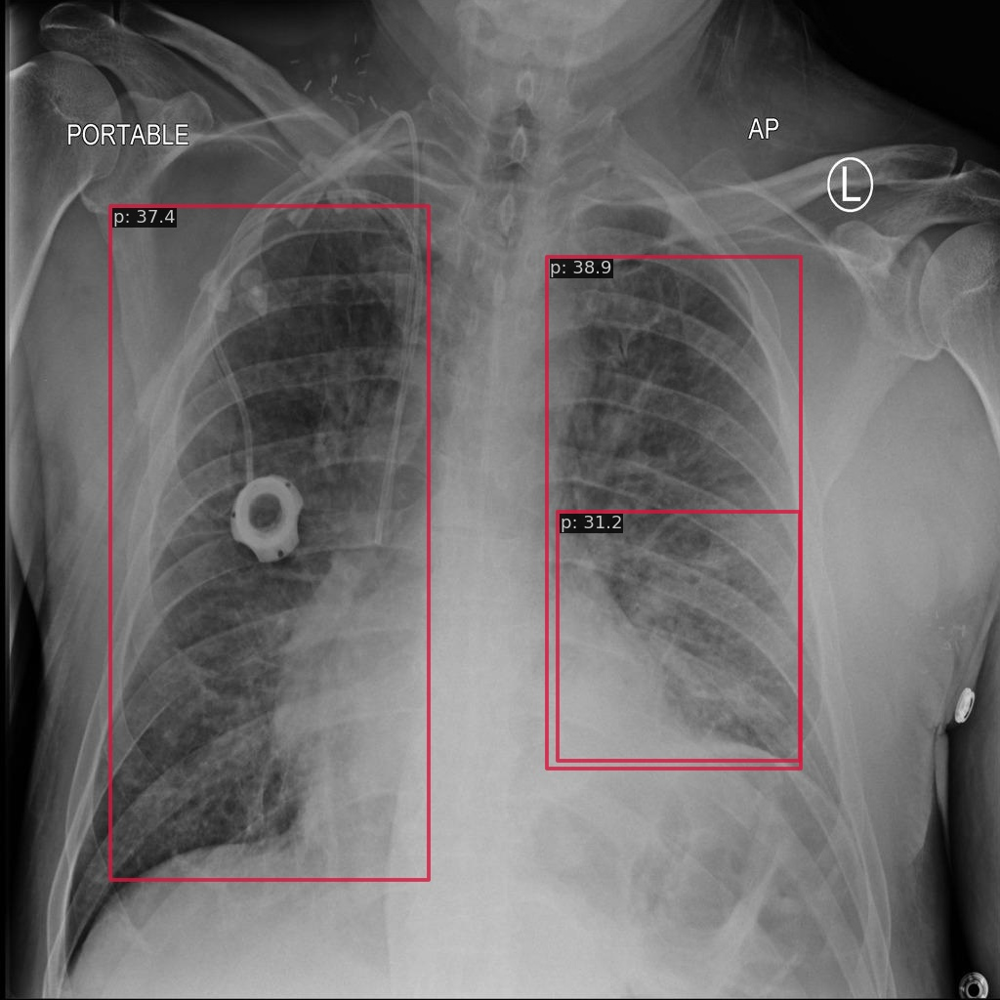

In [32]:
Image.open('/content/mmdetection/output/vis/00b4e593-fcf8-488c-ae55-751034e26f16.jpeg')